In [5]:
from astropy.table import Table
from dendrocat import RadioSource
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from scipy import interpolate
import pandas as pd
import sympy as syp
from astropy import units as u
import radio_beam
from astropy.table import Table
from radio_beam import Beam
from astropy import coordinates
from astropy import wcs
from astropy.nddata.utils import Cutout2D
from dendrocat.aperture import Ellipse
from astropy.io import ascii
import astropy.constants as c

from functools import reduce
from itertools import chain
import Paths.Paths as paths

Path = paths.filepaths()


class core_catdata():
    def __init__(self,catfile, almaimf_beam_b3, almaimf_beam_b6, hrfits, band='B3', recommend_criteria='b6',corr_factor_max=4,iswoff=True):
        catdata_w51e = ascii.read(catfile,data_start=0,format='commented_header', header_start=120,  comment="!")
        ncat = len(catdata_w51e['NO'])
        geo_avg_beam_b3 = np.sqrt(almaimf_beam_b3.major.to(u.arcsec).value*almaimf_beam_b3.minor.to(u.arcsec).value)
        geo_avg_beam_b6 = np.sqrt(almaimf_beam_b6.major.to(u.arcsec).value*almaimf_beam_b6.minor.to(u.arcsec).value)

        corr_factor = catdata_w51e['AFWHM02'] * catdata_w51e['BFWHM02'] / catdata_w51e['AFWHM03'] / catdata_w51e['BFWHM03'] # cor = gets[i][37]*gets[i][38]/(gets[i][54]*gets[i][55])
        rescaled_3mmflux = catdata_w51e['FXT_BST03'] * corr_factor
       
        isdetectedB3 = np.where((catdata_w51e['SIGNM03']>0.1)&
                                (catdata_w51e['FXP_BST03']>0)&
                                (catdata_w51e['FXT_BST03']>0)&
                                (corr_factor>=1/corr_factor_max)&
                                (corr_factor<=corr_factor_max))[0]
        #notdetectedB3 = [i  if i not in isdetectedB3 for i in range(ncat)]
        #print(catdata_w51e['NO'][isdetectedB3])
        #print(catdata_w51e['NO'][notdetectedB3])
        #print(len(np.where(isdetectedB3)[0]), len(catdata_w51e['SIGNM03']))                    
        
        gamma = np.log10(catdata_w51e['FXT_BST02'] / rescaled_3mmflux)/np.log10(228.918/101.426)
        gamma_for_nob3 = np.log10(catdata_w51e['FXT_BST02'] / rescaled_3mmflux)/np.log10(228.918/101.426)
        free_free_crit = np.array([2 if i in isdetectedB3 else 1 for i in range(ncat)])
        gammadiff = gamma - free_free_crit


        self.rec_ind_b6 = np.where((np.abs(catdata_w51e['GOOD'])>1)&
                           (np.abs(catdata_w51e['SIGN'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (np.sqrt(catdata_w51e['AFWHM02']*catdata_w51e['BFWHM02']) <3 * geo_avg_beam_b6 )

                           
                           )[0]
        self.rec_ind_b6 = np.where((np.abs(catdata_w51e['GOOD'])>1)&
                           (np.abs(catdata_w51e['SIGN'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (np.sqrt(catdata_w51e['AFWHM02']*catdata_w51e['BFWHM02']) <3 * geo_avg_beam_b6 )

                           
                           )[0]
        self.rec_ind_b6b3 = np.where((np.abs(catdata_w51e['GOOD'])>1)&
                           (np.abs(catdata_w51e['SIGN'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (np.sqrt(catdata_w51e['AFWHM03']*catdata_w51e['BFWHM03']) <3 * geo_avg_beam_b3 )&
                           (catdata_w51e['AFWHM03']/catdata_w51e['BFWHM03']<=2)&
                           (np.abs(catdata_w51e['SIGNM03'])>1)&
                           (np.abs(catdata_w51e['GOODM03'])>1)&
                           (catdata_w51e['FXT_BST03']/catdata_w51e['FXT_ERR03']>1)
                           
                           )[0]
        self.rec_ind_b6_woff = np.where((np.abs(catdata_w51e['GOOD'])>1)&
                           (np.abs(catdata_w51e['SIGN'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (np.sqrt(catdata_w51e['AFWHM02']*catdata_w51e['BFWHM02']) <3 * geo_avg_beam_b6 )&

                           (gammadiff>0)
                           )[0]
        """
        self.rec_ind_b6_woff = np.where((np.abs(catdata_w51e['GOODM02'])>1)&
                           (np.abs(catdata_w51e['SIGNM02'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (np.sqrt(catdata_w51e['AFWHM02']*catdata_w51e['BFWHM02']) <4 * geo_avg_beam_b6 )&

                           (gammadiff>0)
                           )[0]
        """
        self.rec_ind_b6b3_woff = np.where((np.abs(catdata_w51e['GOOD'])>1)&
                           (np.abs(catdata_w51e['SIGN'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (np.sqrt(catdata_w51e['AFWHM03']*catdata_w51e['BFWHM03']) <3 * geo_avg_beam_b3 )&
                           (catdata_w51e['AFWHM03']/catdata_w51e['BFWHM03']<=2)&
                           (np.abs(catdata_w51e['SIGNM03'])>1)&
                           (np.abs(catdata_w51e['GOODM03'])>1)&
                           (catdata_w51e['FXT_BST03']/catdata_w51e['FXT_ERR03']>1)&
                           (gammadiff>0)
                           )[0]
        if recommend_criteria == 'b6':
            if iswoff:
                rec_ind_prep = self.rec_ind_b6_woff
            else:
                rec_ind_prep = self.rec_ind_b6
        elif recommend_criteria == 'b6b3':
            if iswoff:
                rec_ind_prep = self.rec_ind_b6b3_woff
            else:
                rec_ind_prep = self.rec_ind_b6b3

        
        
       
        yso_image = fits.open(hrfits)[0].data[0][0]
        hrhdr = fits.open(hrfits)[0].header
        inside_idx = exist_inside_FOV(catdata_w51e['WCS_ACOOR'], catdata_w51e['WCS_DCOOR'], yso_image, hrhdr)

        if isinstance(recommend_criteria, list):
            print('catdata_w51e',list(catdata_w51e['NO']), recommend_criteria)
            for i in range(len(catdata_w51e['NO'])):
                if catdata_w51e['NO'][i] in recommend_criteria:
                    print('catdata_w51e',i, catdata_w51e['NO'][i])    
            rec_ind = np.array([i for i in range(len(catdata_w51e['NO'])) if catdata_w51e['NO'][i] in recommend_criteria])
            print(catdata_w51e['NO'][rec_ind])
        else:
            rec_ind = np.intersect1d(rec_ind_prep, inside_idx)
        print('total core number = ', len(catdata_w51e['WCS_ACOOR']))
        print(hrfits)
        if not isinstance(recommend_criteria, list):
            print('robust %s measurement before applying FoV criteria = '%recommend_criteria, len(rec_ind_prep))
            print('robust %s measurement after applying FoV criteria = '%recommend_criteria, len(rec_ind))
       
        self.sky_ra = catdata_w51e['WCS_ACOOR'][rec_ind]
        self.sky_dec = catdata_w51e['WCS_DCOOR'][rec_ind]
        self.pix_x = catdata_w51e['XCO_P'][rec_ind]
        self.pix_y = catdata_w51e['YCO_P'][rec_ind]
        
        if band=='B3':
            bandind = 3
        else:
            bandind = 2

        self.afwhm = catdata_w51e['AFWHM0%d'%bandind][rec_ind] #arcsec
        self.bfwhm = catdata_w51e['BFWHM0%d'%bandind][rec_ind]

        self.asize = catdata_w51e['ASIZE0%d'%bandind][rec_ind]
        self.bsize = catdata_w51e['BSIZE0%d'%bandind][rec_ind]

        self.theta = catdata_w51e['THETA0%d'%bandind][rec_ind]
        
        self.flux = catdata_w51e['FXT_BST0%d'%bandind][rec_ind]
        self.fluxerr = catdata_w51e['FXT_ERR0%d'%bandind][rec_ind]
        self.flux_g = catdata_w51e['FXT_ALT0%d'%bandind][rec_ind]

        self.fooa = catdata_w51e['FOOA0%d'%bandind][rec_ind]
        self.foob = catdata_w51e['FOOB0%d'%bandind][rec_ind]
        
        self.int_peak = catdata_w51e['FXP_BST0%d'%bandind][rec_ind]
        self.interr_peak = catdata_w51e['FXP_ERR0%d'%bandind][rec_ind]
        
        self.size = (catdata_w51e['AFWHM0%d'%bandind][rec_ind]*catdata_w51e['BFWHM0%d'%bandind][rec_ind]**2)**(1/3)


        self.no = catdata_w51e['NO'][rec_ind]

        
        
        rescaled_3mmflux = catdata_w51e['FXT_BST03'][rec_ind] * catdata_w51e['AFWHM02'][rec_ind] * catdata_w51e['BFWHM02'][rec_ind] / catdata_w51e['AFWHM03'][rec_ind]/catdata_w51e['BFWHM03'][rec_ind]
        gamma = np.log10(catdata_w51e['FXT_BST02'][rec_ind] / rescaled_3mmflux)/np.log10(228.918/101.426)
        dd = ((catdata_w51e['SIGNM03']>0.1), (catdata_w51e['FXP_BST03']>0), (catdata_w51e['FXT_BST03']>0), (corr_factor>=1/corr_factor_max),(corr_factor<=corr_factor_max))
        dd2 = ((np.abs(catdata_w51e['GOODM02'])>1),(np.abs(catdata_w51e['SIGNM02'])>1),(catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2),(catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2),
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2),
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15),
                           (gammadiff>0))                 
        if isinstance(recommend_criteria, list):
            for i, ind in enumerate(rec_ind):
                print(catdata_w51e['NO'][ind], 'gamma, ', gamma[i], catdata_w51e['SIGNM03'][ind], catdata_w51e['FXP_BST03'][ind], catdata_w51e['FXT_BST03'][ind], corr_factor[ind], rescaled_3mmflux[i], np.logical_and.reduce(dd)[ind], np.logical_and.reduce(dd2)[ind])
        self.woffind = np.where(gamma>2)[0]
        self.wffind = np.where(gamma<2)[0]
        self.rec_ind = rec_ind

        
    def get_temperature(self,tempfile,threshold=2e-4):
        tab = ascii.read(tempfile, data_start=4)
        ra = tab['col2']
        dec = tab['col3']
        temp = tab['col4']

        temparr = []
        for i in range(len(self.sky_ra)):
            dist = np.sqrt((self.sky_ra[i]-ra)**2+(self.sky_dec[i]-dec)**2) #deg
            mindist = np.min(dist)
            if mindist<threshold:
                index = np.argmin(dist)
                temparr.append(temp[index])
            else:
                temparr.append(np.nan)
        self.temp = np.array(temparr)*u.K
        return np.array(temparr)
    
    def get_coremass(self,freq, kappa, dist):
       
        mass = - 1 / kappa * dist**2 * self.flux  / self.int_peak * np.log(1 - (self.int_peak *u.Jy  / BB(freq,self.temp)).to(u.cm/u.cm).value)
        self.mass = mass.to(u.Msun)
        return mass.to(u.Msun)
    
    def get_coremasserr(self):
        
        masserr = np.abs(self.mass * np.sqrt((self.fluxerr/self.flux)**2+(self.interr_peak/self.int_peak)**2))
        self.masserr = masserr
        return masserr.to(u.Msun)   
    def get_Jeansmass(self, dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3) #arcsec -> au
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)
        c_s = np.sqrt(c.k_B*self.temp/2.8/c.m_p)
        jeans_mass = np.pi**(5/2)/6/c.G**(3/2) * c_s.to(u.cm/u.s)**3 * rho.to(u.g/u.cm**3)**(-1/2)
        
        return jeans_mass.to(u.Msun)

    def get_Jeansmasserr(self,dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3) #arcsec -> au
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)
        c_s = np.sqrt(c.k_B*self.temp/2.8/c.m_p)
        jeans_mass = np.pi**(5/2)/6/c.G**(3/2) * c_s.to(u.cm/u.s)**3 * rho.to(u.g/u.cm**3)**(-1/2)
        rho_err = self.masserr / (4/3*np.pi * (rad*u.au)**3)

        jeans_mass_err = 0.5*jeans_mass * (rho_err/rho)

        return jeans_mass_err.to(u.Msun)
    def get_BE_mass(self, dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3)
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)

        BE_mass = 1.18 * np.sqrt((c.k_B*self.temp/2.33/c.m_p/c.G)**3/rho).to(u.Msun)
        return BE_mass.to(u.Msun)
    
    def get_BE_masserr(self, dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3)
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)

        BE_mass = 1.18 * np.sqrt((c.k_B*self.temp/2.33/c.m_p/c.G)**3/rho).to(u.Msun)
        rho_err = self.masserr / (4/3*np.pi * (rad*u.au)**3)

        BE_mass_err = 0.5*BE_mass * (rho_err/rho)
        return BE_mass_err.to(u.Msun)
    
    
    def multiplicity(self, hdrhr, xysource, almaimf_beam=None,issky=True, label=None,
                 aperture='fwhm+beam',limitarea=None,  maxrad=1e3, verbose=False):
        ncat = len(self.no)
        if limitarea is not None:
            posind = np.where((sky_ra>limitarea[0])&(sky_ra<limitarea[1])&
                              (sky_dec>limitarea[2])&(sky_dec<limitarea[3]))[0]
        else:
            posind = np.arange(ncat)
        if label is None:
            label=np.arange(ncat)
        coreidx = np.arange(ncat)

        totalind = np.intersect1d(posind, label)
        print('totalind',totalind)
        sky_ra = self.sky_ra[totalind]
        sky_dec = self.sky_dec[totalind]
        fooa = self.fooa[totalind]
        foob = self.foob[totalind]
        theta = self.theta[totalind]
        no = self.no[totalind]
        afwhm =self.afwhm[totalind]
        bfwhm = self.bfwhm[totalind]

        skypos = np.vstack((sky_ra,sky_dec)).T


        wcshr = WCS(hdrhr,naxis=2)
        scalehr = wcshr.proj_plane_pixel_scales()[0]

        xypos_core = wcshr.wcs_world2pix(skypos,0)
        xpos_core = xypos_core[:,0]
        ypos_core = xypos_core[:,1]

        if issky:
            xysource_pix = wcshr.wcs_world2pix(xysource,0)
        else:
            xysource_pix = xysource
        ysonumarr=[] ; coreindarr=[]; ysoindarr=[]
        prestellar_ind = []
        protostellar_ind = []
        #print(xysource)
        for i in range(len(xypos_core)):
            if aperture is 'footprint':
                major = fooa[i]/3600/scalehr.value
                minor = foob[i]/3600/scalehr.value
                pa = theta[i]+90
            elif aperture is 'fwhm+beam':
                meanbeamsize = (almaimf_beam.major.value+almaimf_beam.minor.value)/4
                major = (afwhm[i]/3600+meanbeamsize)/scalehr.value
                minor = (bfwhm[i]/3600+meanbeamsize)/scalehr.value
                pa = theta[i]+90
            elif aperture is 'beam':
                major = almaimf_beam.major.value/scalehr.value
                minor = almaimf_beam.minor.value/scalehr.value
                pa = almaimf_beam.pa.value+90
            #if major > maxrad:
            #    continue

            numsource, indsource = count_points_in_ellipse(xpos_core[i],ypos_core[i],major,minor,pa,xysource_pix[:,0],xysource_pix[:,1])
            print(totalind[i], indsource, numsource)
            ysonumarr.append(numsource)
            coreindarr.append(totalind[i])
            ysoindarr.append(indsource)
            if numsource==0:
                prestellar_ind.append(totalind[i])
            elif numsource>0:
                protostellar_ind.append(totalind[i])
            
            
      
        ysoindarr_flat = []
        for arr in ysoindarr:
            ysoindarr_flat.extend(arr)
       
        print('cores with/without YSOs ', len(np.where(np.array(ysonumarr)!=0)[0]), len(xpos_core)-len(np.where(np.array(ysonumarr)!=0)[0]))
        print('YSOs associated with cores',len(np.unique(ysoindarr_flat)),' out of ',len(xysource_pix[:,0]))
              
        self.ysonumarr = ysonumarr
        self.coreindarr = coreindarr
        self.ysoindarr = ysoindarr
        self.prestellar_ind = prestellar_ind
        self.protostellar_ind = protostellar_ind
        print('pre,pro',self.prestellar_ind, self.protostellar_ind)
        return ysonumarr, coreindarr, ysoindarr, prestellar_ind, protostellar_ind
        
        
    
        
        
    

                
            
def BB(freq, temp):
    B_nu = (2 * freq**3 *c.h / (c.c**2) * 1 / (np.e**(c.h*freq/(c.k_B*temp))-1))
    return B_nu        

def kappa(nu, nu0=271.1*u.GHz, kappa0=0.0114*u.cm**2*u.g**-1, beta=1.75):
    """
    Compute the opacity $\kappa$ given a reference frequency (or wavelength)
    and a power law governing the opacity as a fuction of frequency:
    $$ \kappa = \kappa_0 \left(\\frac{\\nu}{\\nu_0}\\right)^{\\beta} $$
    The default kappa=0.0114 at 271.1 GHz comes from extrapolating the
    Ossenkopf & Henning 1994 opacities for the thin-ice-mantle, 10^6 year model
    anchored at 1.0 mm with an assumed beta of 1.75.
    Parameters
    ----------
    nu: astropy.Quantity [u.spectral() equivalent]
        The frequency at which to evaluate kappa
    nu0: astropy.Quantity [u.spectral() equivalent]
        The reference frequency at which $\kappa$ is defined
    kappa0: astropy.Quantity [cm^2/g]
        The dust opacity per gram of H2 along the line of sight.  Because of
        the H2 conversion, this factor implicitly includes a dust to gas ratio
        (usually assumed 100)
    beta: float
        The power-law index governing kappa as a function of nu
    """
    return (kappa0*(nu.to(u.GHz,u.spectral())/nu0.to(u.GHz,u.spectral()))**(beta)).to(u.cm**2/u.g)        

     
"""
def get_BEmass(major, minor, temp ):
    rad = (major * minor**2)**(1/3)
    sigma_th = np.sqrt(c.k_B*temp*u.K/(2.4*c.m_p))
    return (2.4*rad*u.au*sigma_th**2/c.G).to(u.Msun)


"""
def count_points_in_ellipse(xcen,ycen,major,minor,pa,xpos,ypos):
    # caclulate foci positions 
    # must be full major, minor not semi major, minor
    fodx = np.cos(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    fody = np.sin(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    
    fox1 = xcen + fodx
    foy1 = ycen + fody
    
    fox2 = xcen - fodx
    foy2 = ycen - fody
    
    dist1 = np.sqrt((xpos-fox1)**2+(ypos-foy1)**2)
    dist2 = np.sqrt((xpos-fox2)**2+(ypos-foy2)**2)
    
    isinside = np.where(dist1+dist2<major)[0]
    
    return len(isinside), list(isinside)



def exist_inside_FOV(xcore_sky, ycore_sky, yso_image, hrhdr):
    isfinite = np.where(np.isfinite(yso_image))
    xfinite1 = np.min(isfinite[0])
    xfinite2 = np.max(isfinite[0])
    yfinite1 = np.min(isfinite[1])
    yfinite2 = np.max(isfinite[1])
     
    xcen = (xfinite1 + xfinite2)/2
    ycen = (yfinite1 + yfinite2)/2

    wcs_hr = WCS(hrhdr,naxis=2)
    xypos = wcs_hr.wcs_world2pix(np.vstack((xcore_sky,ycore_sky)).T,0)
    
    rad = np.abs(xfinite2 - xcen)
    
    
    dist = np.sqrt((xypos[:,0]- xcen)**2+(xypos[:,1]-ycen)**2)
    isinside = np.where(dist<rad)[0]
    
    return isinside
     




In [6]:
from matplotlib.patches import Rectangle, Ellipse



fitsdata_b3 = fits.open(Path.w51e_b3_tt0)
image_b3_w51e = fitsdata_b3[0].data
if len(image_b3_w51e.shape)>2:
    image_b3_w51e = fitsdata_b3[0].data[0][0]
hdrB3_w51e_hr = fits.getheader(Path.w51e_b3_tt0)  
    
fitsdata_b3 = fits.open(Path.w51n_b3_tt0)
image_b3_w51n = fitsdata_b3[0].data
if len(image_b3_w51n.shape)>2:
    image_b3_w51n = fitsdata_b3[0].data[0][0]
hdrB3_w51n_hr = fits.getheader(Path.w51n_b3_tt0)  

fitsdata_b6 = fits.open(Path.w51e_b6_cont)
image_b6_w51e = fitsdata_b6[0].data
if len(image_b6_w51e.shape)>2:
    image_b6_w51e = fitsdata_b6[0].data[0][0]
hdrB6_w51e_hr = fits.getheader(Path.w51e_b6_cont)  
    
fitsdata_b6 = fits.open(Path.w51n_b6_cont)
image_b6_w51n = fitsdata_b6[0].data
if len(image_b6_w51n.shape)>2:
    image_b6_w51n = fitsdata_b6[0].data[0][0]
hdrB6_w51n_hr = fits.getheader(Path.w51n_b6_cont)  

hdrB6_w51e_almaimf = fits.getheader(Path.w51e_b6_almaimf)  
wcsB6_w51e_almaimf = WCS(hdrB6_w51e_almaimf,naxis=2)
beamb6_w51e_almaimf = Beam.from_fits_header(hdrB6_w51e_almaimf)  

hdrB3_w51e_almaimf = fits.getheader(Path.w51e_b3_almaimf)  
wcsB3_w51e_almaimf = WCS(hdrB3_w51e_almaimf,naxis=2)
beamb3_w51e_almaimf = Beam.from_fits_header(hdrB3_w51e_almaimf) 

hdrB6_w51n_almaimf = fits.getheader(Path.w51n_b6_almaimf)  
wcsB6_w51n_almaimf = WCS(hdrB6_w51n_almaimf,naxis=2)
beamb6_w51n_almaimf = Beam.from_fits_header(hdrB6_w51n_almaimf)  

hdrB3_w51n_almaimf = fits.getheader(Path.w51n_b3_almaimf)  
wcsB3_w51n_almaimf = WCS(hdrB3_w51n_almaimf,naxis=2)
beamb3_w51n_almaimf = Beam.from_fits_header(hdrB3_w51n_almaimf)  

freqb3=92982346121.91989*u.Hz
freqb6=226691598706.70853*u.Hz
kappa_b3 = kappa(freqb3)
kappa_b6 = kappa(freqb6)

core_catdata_w51e_b3_b6crit_b3fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b3_tt0)
core_catdata_w51e_b3_b6crit_b6fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b6_cont)

core_catdata_w51e_b6_b6crit_b3fov = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b3_tt0,band='B6',)
core_catdata_w51e_b6_b6crit_b6fov = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b6_cont, band='B6')

core_catdata_w51e_b3_b6crit_b3fov_wff = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b3_tt0, iswoff=False)
core_catdata_w51e_b3_b6crit_b6fov_wff = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b6_cont, iswoff=False)

core_catdata_w51e_b6_b6crit_b3fov_wff = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b3_tt0,band='B6' ,iswoff=False)
core_catdata_w51e_b6_b6crit_b6fov_wff = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf, beamb6_w51e_almaimf, Path.w51e_b6_cont, band='B6',iswoff=False)

#core_catdata_w51e_b3_b6b3crit_b3fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b3_tt0, recommend_criteria='b6b3')
#core_catdata_w51e_b3_b6b3crit_b6fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b6_cont, recommend_criteria='b6b3')

#core_catdata_w51e_b6_b6b3crit_b3fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b3_tt0, band='B6', recommend_criteria='b6b3')
#core_catdata_w51e_b6_b6b3crit_b6fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b6_cont,band='B6', recommend_criteria='b6b3')

core_catdata_w51n_b3_b6crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b3_tt0)
core_catdata_w51n_b3_b6crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b6_cont)

core_catdata_w51n_b6_b6crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b3_tt0, band='B6')
core_catdata_w51n_b6_b6crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b6_cont, band='B6')

core_catdata_w51n_b3_b6crit_b3fov_wff = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b3_tt0,iswoff=False)
core_catdata_w51n_b3_b6crit_b6fov_wff = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b6_cont,iswoff=False)

core_catdata_w51n_b6_b6crit_b3fov_wff = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b3_tt0, band='B6',iswoff=False)
core_catdata_w51n_b6_b6crit_b6fov_wff = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,beamb6_w51n_almaimf, Path.w51n_b6_cont, band='B6',iswoff=False)

#core_catdata_w51n_b3_b6b3crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b3_tt0, recommend_criteria='b6b3')
#core_catdata_w51n_b3_b6b3crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b6_cont, recommend_criteria='b6b3')

#core_catdata_w51n_b6_b6b3crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b3_tt0,band='B6', recommend_criteria='b6b3')
#core_catdata_w51n_b6_b6b3crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b6_cont, band='B6', recommend_criteria='b6b3')

core_catdata_w51e_fabien = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, beamb6_w51e_almaimf,Path.w51e_b3_tt0, recommend_criteria=[[2,4,8,11,12,13,14,15,16,17,19,20,21,22,26,28,29,30,31,33,34,38,39],[1,3,5,6,9,10,18,27]],band='B6',)
core_catdata_w51n_fabien = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, beamb6_w51n_almaimf,Path.w51n_b3_tt0, recommend_criteria=[1,2,4,6,7,8,9,10,11,12,13,14,15,16,17,19,20,22,23,24,25,26,27,28,29,31,32,33,34,35,37,38,40,41,42,43,44,45,46,47,48,
49,51,52,53,54,55,57,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,84,85,86,87,88,89,90,91,92,94,95,97,99,100,101,102,104,105,106,107,108,109,111,114,117,119,122,123],band='B6',)


"""
coretemp_w51e_b6crit = core_catdata_w51e_b6_b6crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51e_b6crit = core_catdata_w51e_b6_b6crit.get_temperature(Path.w51e_almaimf_coretemp)

coretemp_w51n_b6crit = core_catdata_w51n_b6_b6crit.get_temperature(Path.w51n_almaimf_coretemp)
coretemp_w51e_b6crit = core_catdata_w51e_b6_b6crit.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51n_b6crit = core_catdata_w51n_b6_b6crit.get_temperature(Path.w51n_almaimf_coretemp)

coremass_w51e = core_catdata_w51e_b6_b6crit.get_coremass(freqb6, kappa_b6, 5.41*u.kpc)
coremass_w51n = core_catdata_w51n_b6_b6crit.get_coremass(freqb6, kappa_b6, 5.1*u.kpc)
coremasserr_w51e = core_catdata_w51e_b6_b6crit.get_coremasserr()
coremasserr_w51n = core_catdata_w51n_b6_b6crit.get_coremasserr()
"""
#b3fov
"""
multiplicity_w51e_b3fov = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b3fov)

multiplicity_w51n_b3fov = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                
                                label=isinside_w51n_b3fov)

multiplicity_w51e_b6crit_b3fov = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b3fov_woff)
multiplicity_w51n_b3fov_woff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b3fov_woff)

multiplicity_w51e_b3fov_wff = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b3fov_wff)
multiplicity_w51n_b3fov_wff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b3fov_wff)

#b6fov
multiplicity_w51e_b6fov = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b6fov)
multiplicity_w51n_b6fov = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b6fov)

multiplicity_w51e_b6fov_woff = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b6fov_woff)
multiplicity_w51n_b6fov_woff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b6fov_woff)

multiplicity_w51e_b6fov_wff = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b6fov_wff)
multiplicity_w51n_b6fov_wff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b6fov_wff)

"""
catalog_w51e_yso = Table.read(Path.w51e_dendro_matched_catalog ,format='fits')
yso_w51e_xsky_b6 = catalog_w51e_yso['b6_xsky'] ; yso_w51e_ysky_b6 = catalog_w51e_yso['b6_ysky']
yso_w51e_xsky_b3 = catalog_w51e_yso['b3_xsky'] ; yso_w51e_ysky_b3 = catalog_w51e_yso['b3_ysky']

yso_detect_w51e_b6 = np.where(yso_w51e_xsky_b6>0)[0]
yso_detect_w51e_b3 = np.where(yso_w51e_xsky_b3>0)[0]


catalog_w51n_yso = Table.read(Path.w51n_dendro_matched_catalog ,format='fits')
yso_w51n_xsky_b6 = catalog_w51n_yso['b6_xsky'] ; yso_w51n_ysky_b6 = catalog_w51n_yso['b6_ysky']
yso_w51n_xsky_b3 = catalog_w51n_yso['b3_xsky'] ; yso_w51n_ysky_b3 = catalog_w51n_yso['b3_ysky']


yso_xsky_w51e = []
for i,x in enumerate(yso_w51e_xsky_b6):
    if x > 0:
        yso_xsky_w51e.append(x)
    else:
        yso_xsky_w51e.append(yso_w51e_xsky_b3[i])
yso_ysky_w51e = []
for i,x in enumerate(yso_w51e_ysky_b6):
    if x > 0:
        yso_ysky_w51e.append(x)
    else:
        yso_ysky_w51e.append(yso_w51e_ysky_b3[i])

yso_xsky_w51n = []
for i,x in enumerate(yso_w51n_xsky_b6):
    if x > 0:
        yso_xsky_w51n.append(x)
    else:
        yso_xsky_w51n.append(yso_w51n_xsky_b3[i])
yso_ysky_w51n = []
for i,x in enumerate(yso_w51n_ysky_b6):
    if x > 0:
        yso_ysky_w51n.append(x)
    else:
        yso_ysky_w51n.append(yso_w51n_ysky_b3[i])
"""
#whether the core is inside the FOV
isinside_w51e_b3fov_b6crit = exist_inside_FOV(core_catdata_w51e_b6_b6crit.sky_ra, core_catdata_w51e_b6_b6crit.sky_dec, image_b3_w51e, hdrB3_w51e_hr) 
isinside_w51e_b6fov_b6crit = exist_inside_FOV(core_catdata_w51e_b6_b6crit.sky_ra, core_catdata_w51e_b6_b6crit.sky_dec, image_b6_w51e, hdrB6_w51e_hr)
isinside_w51n_b3fov_b6crit = exist_inside_FOV(core_sky_ra_w51n_b6, core_sky_dec_w51n_b6, image_b3_w51n, hdrB3_w51n_hr)
isinside_w51n_b6fov_b6crit = exist_inside_FOV(core_sky_ra_w51n_b6, core_sky_dec_w51n_b6, image_b6_w51n, hdrB6_w51n_hr)


#print('ho',isinside_w51e_b3)
isinside_w51e_b3fov_woff = np.intersect1d(isinside_w51e_b3fov,  core_catdata_w51e_b3.woffind)
isinside_w51n_b3fov_woff = np.intersect1d(isinside_w51n_b3fov,  core_catdata_w51n_b3.woffind)
isinside_w51e_b6fov_woff = np.intersect1d(isinside_w51e_b6fov,  core_catdata_w51e_b6.woffind)
isinside_w51n_b6fov_woff = np.intersect1d(isinside_w51n_b6fov,  core_catdata_w51n_b6.woffind)
#print(isinside_w51e_b3_woff)

isinside_w51e_b3fov_wff = np.intersect1d(isinside_w51e_b3fov,  core_catdata_w51e_b3.wffind)
isinside_w51n_b3fov_wff = np.intersect1d(isinside_w51n_b3fov,  core_catdata_w51n_b3.wffind)
isinside_w51e_b6fov_wff = np.intersect1d(isinside_w51e_b6fov,  core_catdata_w51e_b6.wffind)
isinside_w51n_b6fov_wff = np.intersect1d(isinside_w51n_b6fov,  core_catdata_w51n_b6.wffind)
"""

yso_xysource_w51e= np.vstack((yso_xsky_w51e, yso_ysky_w51e)).T
yso_xysource_w51n= np.vstack((yso_xsky_w51n, yso_ysky_w51n)).T

hdrhr_w51n_b3= fits.getheader(Path.w51n_b3_tt0) 
hdrhr_w51e_b3= fits.getheader(Path.w51e_b3_tt0) 
hdrhr_w51n_b6= fits.getheader(Path.w51n_b6_cont) 
hdrhr_w51e_b6= fits.getheader(Path.w51e_b6_cont) 

ysogroup_w51e = catalog_w51e_yso['group']
ysogroup_w51n = catalog_w51n_yso['group']

print('ho')
print(core_catdata_w51e_b3_b6crit_b3fov.no)
print(core_catdata_w51n_b3_b6crit_b3fov.no)

multiplicity_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf)

multiplicity_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,)
multiplicity_w51e_b6crit_b3fov_wff = core_catdata_w51e_b6_b6crit_b3fov_wff.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf)

multiplicity_w51n_b6crit_b3fov_wff = core_catdata_w51n_b6_b6crit_b3fov_wff.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,)
                                



total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits
robust b6 measurement before applying FoV criteria =  21
robust b6 measurement after applying FoV criteria =  21
total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/w51e2.spw0thru19.14500.robust0.thr0.15mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits
robust b6 measurement before applying FoV criteria =  21
robust b6 measurement after applying FoV criteria =  11
total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits
robust b6 measurement before applying FoV criteria =  21
robust b6 measurement after applying FoV criteria =  21
total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/w51e2.spw0thru19.14500.robust0.thr0.15mJy.mfs.I.startmod.s

1 [7250.813242   7239.96570972]
2 [7136.94741313 7238.93719441]
3 [11482.55097265 10409.79294667]
4 [7275.2594954  6333.02285552]
5 [7321.66185589 7443.52001798]
6 [2528.01163928  427.57796597]
8 [7210.88312945 7528.27428786]
9 [2410.80476564  469.44574289]
10 [7505.43448296 5498.33742584]
11 [12289.56469214  4384.60866891]
12 [7085.8642801  7000.87439945]
13 [7504.14079873 5125.84028089]
14 [7424.87269485 7514.80012971]
15 [7973.33976117 7428.81372166]
16 [7351.53598449 6091.30861243]
17 [8734.47381117 9585.37538459]
18 [10387.53074715  3436.04323385]
19 [7362.93565463 8071.56576561]
20 [10927.10332919  8098.47080062]
21 [9930.03017592 2613.94584037]
22 [9827.60696434 2814.25775908]
26 [11511.09453972  9991.26829886]
27 [7000.5749584  6181.20598316]
28 [7729.8277935  6913.13814934]
29 [8902.40040037 9989.40055356]
30 [10604.16687979 10195.76939678]
31 [ 9309.30064114 10523.03004044]
33 [10380.76620453  3185.27733551]
34 [7460.81691419 9049.48018948]
38 [6257.37953401 6335.70146521]
39

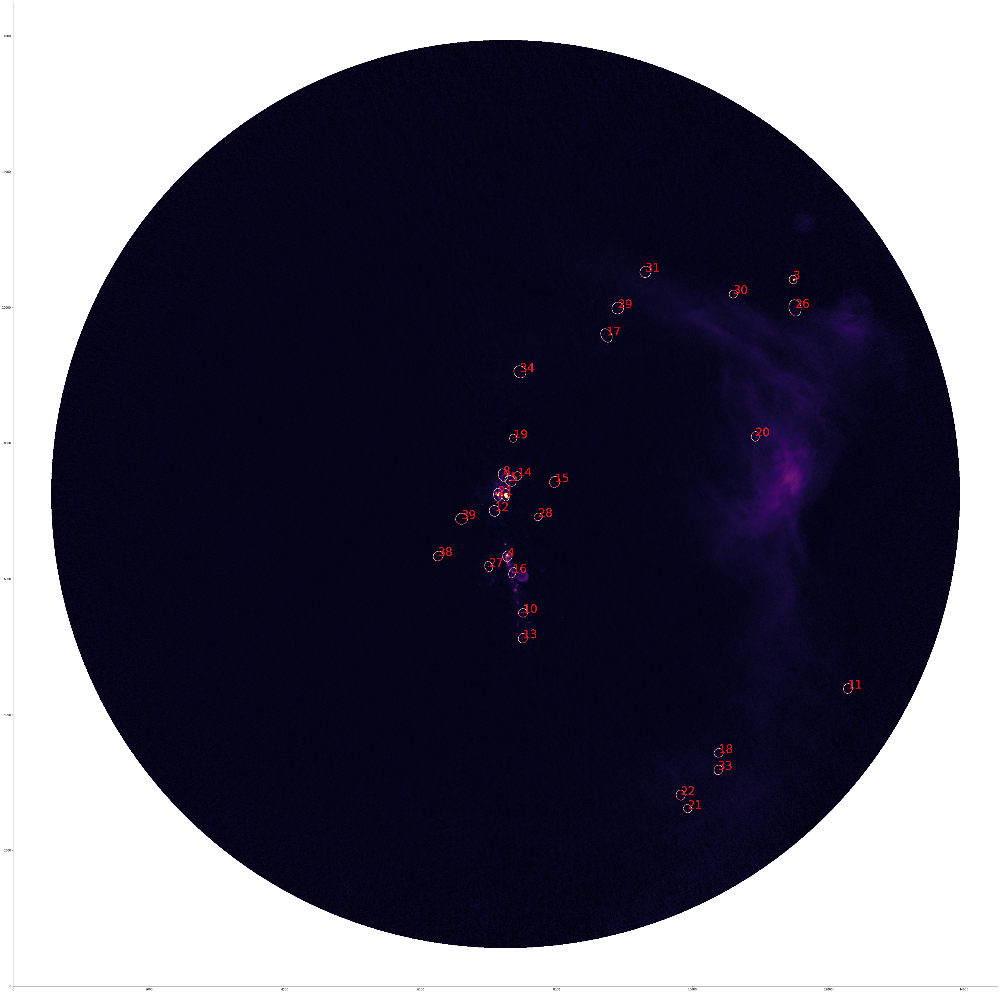

In [7]:
def plot_cores(ax, skypos, afwhm, bfwhm, theta, hdrhr, beam_almaimf,color='cyan', lw=2, ls='solid', label=None,fontsize=40):
    wcsNB = WCS(hdrhr,naxis=2)
    scalehr = wcsNB.proj_plane_pixel_scales()[0]
    xypos = wcsNB.wcs_world2pix(skypos,0)

    for i in range(len(xypos)):
        print(label[i], xypos[i])
        meanbeamsize = (beam_almaimf.major.value+beam_almaimf.minor.value)/4
        major = (afwhm[i]/3600+meanbeamsize)/scalehr.value
        minor = (bfwhm[i]/3600+meanbeamsize)/scalehr.value
        pa = 90+theta[i]
        ellipse = Ellipse(xypos[i],width=major,height=minor,facecolor='none',
                          angle=180-pa,edgecolor=color,lw=lw, ls=ls) 
        ax.add_patch(ellipse)
        if label is not None:
            if isinstance(label[i],u.Quantity):
                ax.text(xypos[i][0],xypos[i][1],'%3.2f'%label[i].value,color=color,fontsize=8) 
            else:
                ax.text(xypos[i][0],xypos[i][1],label[i],color=color,fontsize=fontsize)

no_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.no[multiplicity_w51e_b6crit_b3fov[1]]
no_w51e_b6crit_b3fov_wff = core_catdata_w51e_b6_b6crit_b3fov_wff.no[multiplicity_w51e_b6crit_b3fov_wff[1]]

no_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.no[multiplicity_w51n_b6crit_b3fov[1]]
no_w51n_b6crit_b3fov_wff = core_catdata_w51n_b6_b6crit_b3fov_wff.no[multiplicity_w51n_b6crit_b3fov_wff[1]]

prestellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[3]
prestellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[3]
protostellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[4]
protostellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[4]
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.imshow(image_b3_w51e, cmap='inferno',origin='lower', vmin=-0.000103489713773963128,vmax=0.002216252472302186)


skypos_w51e_fabien = np.vstack((core_catdata_w51e_fabien.sky_ra, core_catdata_w51e_fabien.sky_dec)).T
plot_cores(ax1, skypos_w51e_fabien, core_catdata_w51e_fabien.afwhm, core_catdata_w51e_fabien.bfwhm, core_catdata_w51e_fabien.theta, 
           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='w', lw=2, label=core_catdata_w51e_fabien.no)

#skypos_w51e_b6_b6crit_b3fov = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra, core_catdata_w51e_b6_b6crit_b3fov.sky_dec)).T
#lot_cores(ax1, skypos_w51e_b6_b6crit_b3fov, core_catdata_w51e_b6_b6crit_b3fov.afwhm, core_catdata_w51e_b6_b6crit_b3fov.bfwhm, core_catdata_w51e_b6_b6crit_b3fov.theta, 
 #          hdrB3_w51e_hr, beamb6_w51e_almaimf, color='cyan', lw=2, label=no_w51e_b6crit_b3fov, )

skypos_w51e_b6_b6crit_b3fov_wff = np.vstack((core_catdata_w51e_b6_b6crit_b3fov_wff.sky_ra, core_catdata_w51e_b6_b6crit_b3fov_wff.sky_dec)).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_wff, core_catdata_w51e_b6_b6crit_b3fov_wff.afwhm, core_catdata_w51e_b6_b6crit_b3fov_wff.bfwhm, core_catdata_w51e_b6_b6crit_b3fov_wff.theta, 
           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='r', lw=2, label=no_w51e_b6crit_b3fov_wff, ls='dotted')

#plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov, core_catdata_w51e_b6_b6crit_b3fov.afwhm, core_catdata_w51e_b6_b6crit_b3fov.bfwhm, core_catdata_w51e_b6_b6crit_b3fov.theta, 
#           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='w', lw=2, label=no_w51e_b6crit_b3fov)

#skypos_w51e_b6_b6crit_b3fov_prestellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra, core_catdata_w51e_b6_b6crit_b3fov.sky_dec)).T
#plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], 
#           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='cyan', lw=2, label=no_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov])

#skypos_w51e_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.sky_dec[protostellar_w51e_b6crit_b3fov])).T
#plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_protostellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[protostellar_w51e_b6crit_b3fov], 
#           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='lime', lw=2, label=no_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov])

plt.savefig('w51e_coremap_fabien.png')
plt.show()

1 [7148.81753838 7318.93718042]
2 [7347.71405835 7303.50860596]
3 [3382.88491963 6065.32856055]
4 [10208.97437413  3932.76418499]
5 [7615.01718974 7262.88057803]
6 [7259.79132944 7371.7542787 ]
7 [7773.68627363 7289.46976906]
8 [10989.62946097  7518.79858564]
9 [10383.83323706  3788.66600996]
10 [9979.88751698 4474.96988446]
11 [6208.4506818  7089.93047362]
12 [11278.54512804  7351.25416163]
13 [12562.54873175   654.84405456]
14 [10971.31623911  2701.68942932]
15 [10559.80067421  3204.39099659]
16 [11201.27383819  7434.25716653]
17 [3301.90362411 8134.45705654]
18 [7376.63948966 7705.62863444]
19 [3137.90504736 8038.03429345]
20 [12725.783366    7372.50317344]
22 [2816.07071753 3759.13781254]
23 [4666.90221314 8828.4978825 ]
24 [9835.33346518 7575.18364799]
25 [8251.04041783 7016.13011004]
26 [5144.33660133 2880.82520456]
27 [11381.1738941  8196.1778417]
28 [12914.61837345  7464.15813161]
29 [9686.10673934 3733.31179141]
31 [9447.73546905 3042.82694381]
32 [12089.47334737  1301.9486527

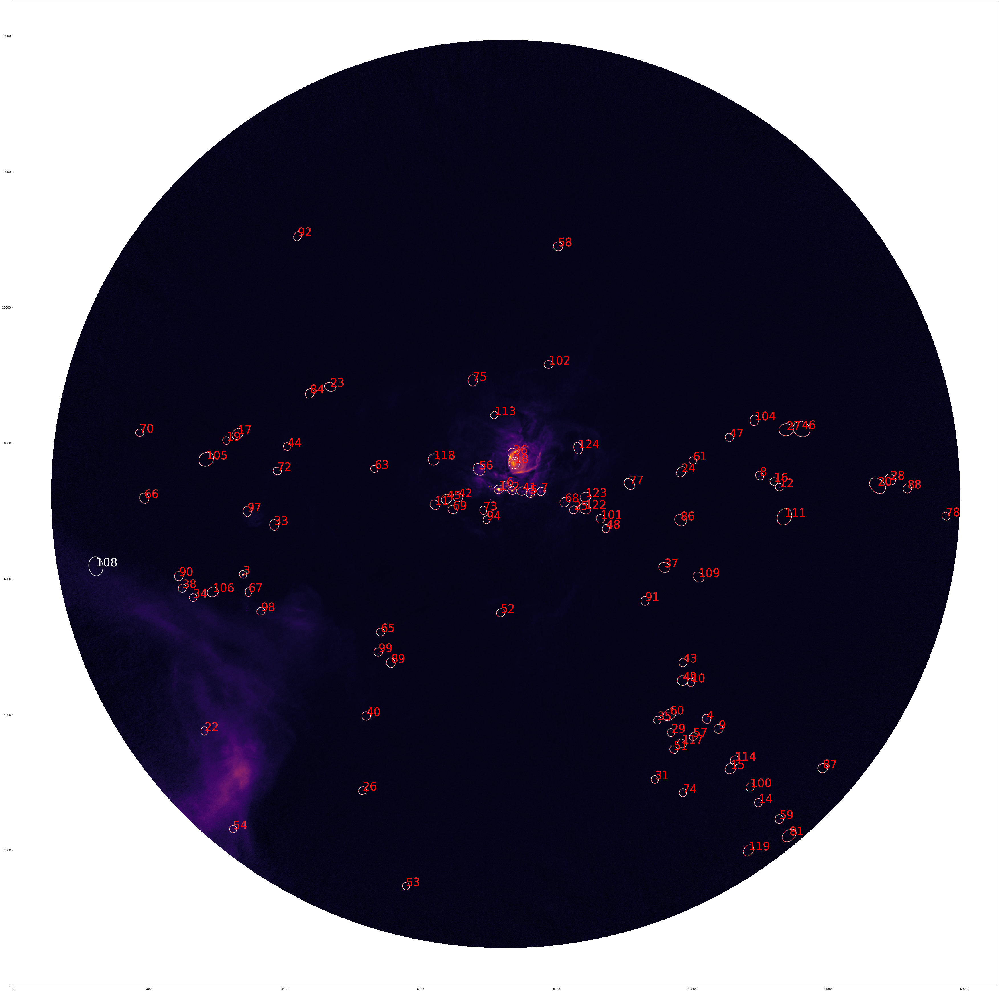

In [8]:
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.imshow(image_b3_w51n, cmap='inferno',origin='lower', vmin=-0.000103489713773963128,vmax=0.002216252472302186)
 
#skypos_w51n_b6_b6crit_b3fov = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra, core_catdata_w51n_b6_b6crit_b3fov.sky_dec)).T
#plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov, core_catdata_w51n_b6_b6crit_b3fov.afwhm, core_catdata_w51n_b6_b6crit_b3fov.bfwhm, core_catdata_w51n_b6_b6crit_b3fov.theta, 
#           hdrB3_w51n_hr, beamb6_w51n_almaimf, color='w', lw=2, label=no_w51n_b6crit_b3fov)

skypos_w51n_fabien = np.vstack((core_catdata_w51n_fabien.sky_ra, core_catdata_w51n_fabien.sky_dec)).T
plot_cores(ax1, skypos_w51n_fabien, core_catdata_w51n_fabien.afwhm, core_catdata_w51n_fabien.bfwhm, core_catdata_w51n_fabien.theta, 
           hdrB3_w51n_hr, beamb6_w51n_almaimf, color='w', lw=2, label=core_catdata_w51n_fabien.no)

#skypos_w51n_b6_b6crit_b3fov = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra, core_catdata_w51n_b6_b6crit_b3fov.sky_dec)).T
#plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov, core_catdata_w51n_b6_b6crit_b3fov.afwhm, core_catdata_w51n_b6_b6crit_b3fov.bfwhm, core_catdata_w51n_b6_b6crit_b3fov.theta, 
#           hdrB3_w51n_hr, beamb6_w51n_almaimf, color='cyan', lw=2, label=no_w51n_b6crit_b3fov, )

skypos_w51n_b6_b6crit_b3fov_wff = np.vstack((core_catdata_w51n_b6_b6crit_b3fov_wff.sky_ra, core_catdata_w51n_b6_b6crit_b3fov_wff.sky_dec)).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_wff, core_catdata_w51n_b6_b6crit_b3fov_wff.afwhm, core_catdata_w51n_b6_b6crit_b3fov_wff.bfwhm, core_catdata_w51n_b6_b6crit_b3fov_wff.theta, 
           hdrB3_w51n_hr, beamb6_w51n_almaimf, color='r', lw=2, label=no_w51n_b6crit_b3fov_wff, ls='dotted')
plt.savefig('w51n_coremap_fabien.png')
plt.show()